In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/nyc-yellow-taxi-trip-data/yellow_tripdata_2016-01.csv
/kaggle/input/nyc-yellow-taxi-trip-data/yellow_tripdata_2016-03.csv
/kaggle/input/nyc-yellow-taxi-trip-data/yellow_tripdata_2016-02.csv
/kaggle/input/nyc-yellow-taxi-trip-data/yellow_tripdata_2015-01.csv


# Scalable Analysis of NYC Taxi Data on Kaggle

This notebook performs sampling, cleaning, geospatial visualization, and SQL analysis of New York City taxi data, using incremental processing for big data. Run each cell step by step to ensure everything works in the cloud environment.

In [2]:
# Import required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap
import os

In [3]:
# Set Kaggle dataset directory and list available CSV files
DATA_DIR = '/kaggle/input/nyc-yellow-taxi-trip-data/'
CSV_FILES = [f for f in os.listdir(DATA_DIR) if f.endswith('.csv')]
print("CSV files found:", CSV_FILES)

CSV files found: ['yellow_tripdata_2016-01.csv', 'yellow_tripdata_2016-03.csv', 'yellow_tripdata_2016-02.csv', 'yellow_tripdata_2015-01.csv']


In [4]:
# Parameters for scalable analysis
DISTANCE_MIN = 0.1   # Minimum valid trip distance (miles)
DISTANCE_MAX = 30.0  # Maximum valid trip distance (miles)

In [5]:
# Function to load and clean all NYC taxi trip CSVs
def load_and_clean_all_data(data_dir, csv_files, dist_min, dist_max):
    """
    Load and concatenate all NYC taxi trip CSVs, clean by filtering outliers in trip distance.
    """
    dfs = []
    for fname in csv_files:
        fpath = os.path.join(data_dir, fname)
        print(f"Loading {fname}...")
        for chunk in pd.read_csv(fpath, chunksize=50000):
            # Filter outliers in chunk
            chunk = chunk[(chunk['trip_distance'] >= dist_min) & (chunk['trip_distance'] <= dist_max)]
            dfs.append(chunk)
    df = pd.concat(dfs, ignore_index=True)
    print(f"Total cleaned rows: {df.shape[0]}")
    return df

In [6]:
# Load and clean all CSVs in data folder
try:
    df_clean = load_and_clean_all_data(DATA_DIR, CSV_FILES, DISTANCE_MIN, DISTANCE_MAX)
    display(df_clean.head())
except Exception as e:
    print(f"Error loading data: {e}")

Loading yellow_tripdata_2016-01.csv...
Loading yellow_tripdata_2016-03.csv...
Loading yellow_tripdata_2016-02.csv...
Loading yellow_tripdata_2015-01.csv...
Total cleaned rows: 46893640


/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1458: RuntimeWarning: invalid value encountered in greater
  has_large_values = (abs_vals > 1e6).any()
/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1459: RuntimeWarning: invalid value encountered in less
  has_small_values = ((abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)).any()
/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1459: RuntimeWarning: invalid value encountered in greater
  has_small_values = ((abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)).any()


,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,pickup_longitude,pickup_latitude,RatecodeID,store_and_fwd_flag,dropoff_longitude,dropoff_latitude,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,RateCodeID
0,2,2016-01-01 00:00:00,2016-01-01 00:00:00,2,1.10,-73.990372,40.734695,1.0,N,-73.981842,40.732407,2,7.5,0.5,0.5,0.0,0.0,0.3,8.8,NaN
1,2,2016-01-01 00:00:00,2016-01-01 00:00:00,5,4.90,-73.980782,40.729912,1.0,N,-73.944473,40.716679,1,18.0,0.5,0.5,0.0,0.0,0.3,19.3,NaN
2,2,2016-01-01 00:00:00,2016-01-01 00:00:00,1,10.54,-73.984550,40.679565,1.0,N,-73.950272,40.788925,1,33.0,0.5,0.5,0.0,0.0,0.3,34.3,NaN
3,2,2016-01-01 00:00:00,2016-01-01 00:00:00,1,4.75,-73.993469,40.718990,1.0,N,-73.962242,40.657333,2,16.5,0.0,0.5,0.0,0.0,0.3,17.3,NaN
4,2,2016-01-01 00:00:00,2016-01-01 00:00:00,3,1.76,-73.960625,40.781330,1.0,N,-73.977264,40.758514,2,8.0,0.0,0.5,0.0,0.0,0.3,8.8,NaN


In [7]:
# Visualize pickup locations with Folium
if 'df_clean' in locals():
    # Center map on NYC
    nyc_coords = [40.7128, -74.0060]
    m = folium.Map(location=nyc_coords, zoom_start=11)
    # Add pickup points (sample for performance)
    for idx, row in df_clean.sample(n=1000).iterrows():
        folium.CircleMarker(
            location=[row['pickup_latitude'], row['pickup_longitude']],
            radius=1,
            color='blue',
            fill=True,
            fill_opacity=0.5
        ).add_to(m)
    # Add heatmap for pickup density
    heat_data = df_clean[['pickup_latitude', 'pickup_longitude']].dropna().sample(n=5000).values.tolist()
    HeatMap(heat_data, radius=8).add_to(m)
    m.save('nyc_pickup_map.html')
    print("Pickup map saved to nyc_pickup_map.html")
else:
    print("No cleaned data available for mapping.")

Pickup map saved to nyc_pickup_map.html


In [8]:
# Total trips per hour using Pandas
df_clean['pickup_hour'] = pd.to_datetime(df_clean['tpep_pickup_datetime']).dt.hour
df_hourly = df_clean.groupby('pickup_hour').size().reset_index(name='total_trips')
display(df_hourly)

,pickup_hour,total_trips
0,0,1676516
1,1,1233575
2,2,907777
3,3,679578
4,4,504867
5,5,469022
6,6,1023460
7,7,1744948
8,8,2141939
9,9,2160268


In [9]:
# Most expensive routes (top 10 by average fare) using Pandas
if 'PULocationID' in df_clean.columns and 'DOLocationID' in df_clean.columns:
    df_expensive = (
        df_clean.groupby(['PULocationID', 'DOLocationID'])
        .agg(avg_fare=('total_amount', 'mean'), trip_count=('total_amount', 'size'))
        .sort_values('avg_fare', ascending=False)
        .head(10)
        .reset_index()
    )
else:
    df_expensive = (
        df_clean.groupby(['pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude'])
        .agg(avg_fare=('total_amount', 'mean'), trip_count=('total_amount', 'size'))
        .sort_values('avg_fare', ascending=False)
        .head(10)
        .reset_index()
    )
display(df_expensive)

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,avg_fare,trip_count
0,-74.002197,40.739552,-73.941200,40.705898,3950611.60,1
1,-73.991638,40.754616,-73.980461,40.763241,111271.65,1
2,-73.922905,40.793941,-73.809334,40.988037,7122.16,1
3,-73.976654,40.765087,-73.961517,40.779530,4009.30,1
4,-73.961533,40.770638,-73.978508,40.749516,4009.30,1
5,-73.956421,40.767014,-73.934425,40.797241,4002.05,1
6,-74.014336,40.711857,-73.985191,40.760464,3006.35,1
7,-73.993965,40.729988,-73.996078,40.730076,2115.97,1
8,-73.987198,40.694801,-73.987328,40.695946,2021.17,1
9,-73.997017,40.758022,-73.996964,40.757893,2021.17,1


In [10]:
df_clean['pickup_hour'] = pd.to_datetime(df_clean['tpep_pickup_datetime']).dt.hour
hourly_trips = df_clean.groupby('pickup_hour').size().reset_index(name='total_trips')
print(hourly_trips)

    pickup_hour  total_trips
0             0      1676516
1             1      1233575
2             2       907777
3             3       679578
4             4       504867
5             5       469022
6             6      1023460
7             7      1744948
8             8      2141939
9             9      2160268
10           10      2093464
11           11      2176633
12           12      2312284
13           13      2309230
14           14      2410105
15           15      2371320
16           16      2137715
17           17      2505283
18           18      2966900
19           19      2958515
20           20      2731395
21           21      2666830
22           22      2548338
23           23      2163678


In [11]:
expensive_routes = (
    df_clean.groupby(['pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude'])
    .agg(avg_fare=('total_amount', 'mean'), trip_count=('total_amount', 'count'))
    .sort_values('avg_fare', ascending=False)
    .head(10)
    .reset_index()
)
print(expensive_routes)

   pickup_longitude  pickup_latitude  dropoff_longitude  dropoff_latitude  \
0        -74.002197        40.739552         -73.941200         40.705898   
1        -73.991638        40.754616         -73.980461         40.763241   
2        -73.922905        40.793941         -73.809334         40.988037   
3        -73.976654        40.765087         -73.961517         40.779530   
4        -73.961533        40.770638         -73.978508         40.749516   
5        -73.956421        40.767014         -73.934425         40.797241   
6        -74.014336        40.711857         -73.985191         40.760464   
7        -73.993965        40.729988         -73.996078         40.730076   
8        -73.987198        40.694801         -73.987328         40.695946   
9        -73.997017        40.758022         -73.996964         40.757893   

     avg_fare  trip_count  
0  3950611.60           1  
1   111271.65           1  
2     7122.16           1  
3     4009.30           1  
4     4009.3

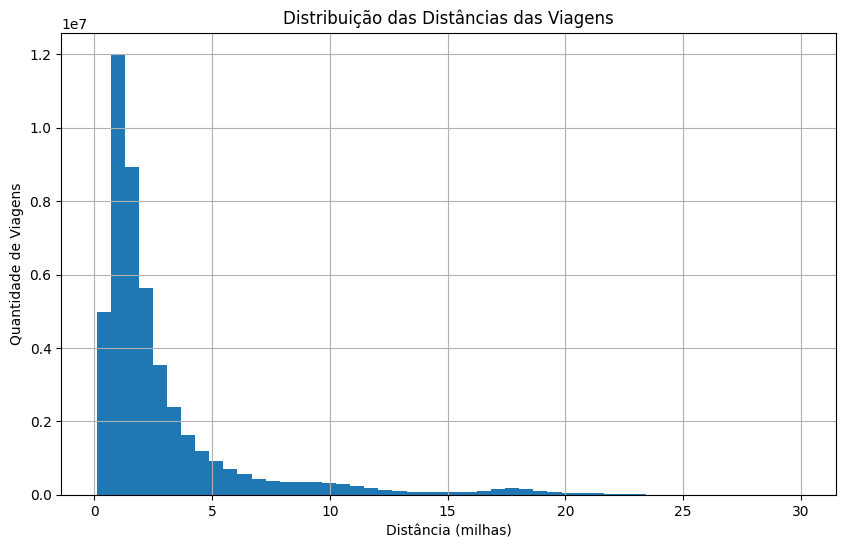

In [12]:
plt.figure(figsize=(10,6))
df_clean['trip_distance'].hist(bins=50)
plt.title('Distribuição das Distâncias das Viagens')
plt.xlabel('Distância (milhas)')
plt.ylabel('Quantidade de Viagens')
plt.show()

In [13]:
sample_df = df_clean.sample(n=100_000)  # Ajuste o tamanho conforme necessário
sample_df['pickup_month'] = pd.to_datetime(sample_df['tpep_pickup_datetime']).dt.to_period('M')
monthly_revenue = sample_df.groupby('pickup_month')['total_amount'].sum().reset_index()
print(monthly_revenue)

  pickup_month  total_amount
0      2015-01     397997.66
1      2016-01     358118.09
2      2016-02     372589.45
3      2016-03     414286.89


In [14]:
import numpy as np

# Create pickup_month column
if np.issubdtype(df_clean['tpep_pickup_datetime'].dtype, np.datetime64):
    df_clean['pickup_month'] = df_clean['tpep_pickup_datetime'].dt.to_period('M')
else:
    df_clean['pickup_month'] = pd.to_datetime(df_clean['tpep_pickup_datetime'], errors='coerce').dt.to_period('M')

# Group by pickup_month and sum total_amount
monthly_revenue = df_clean.groupby('pickup_month')['total_amount'].sum().reset_index()

# Display the result
print(monthly_revenue)

  pickup_month  total_amount
0      2015-01  1.902554e+08
1      2016-01  1.682704e+08
2      2016-02  1.749214e+08
3      2016-03  1.928101e+08


In [15]:
# Export and display total trips per hour
print(hourly_trips)
hourly_trips.to_csv('hourly_trips.csv', index=False)

# Export and display most expensive routes
print(expensive_routes)
expensive_routes.to_csv('expensive_routes.csv', index=False)

# Export and display total monthly revenue
print(monthly_revenue)
monthly_revenue.to_csv('monthly_revenue.csv', index=False)

    pickup_hour  total_trips
0             0      1676516
1             1      1233575
2             2       907777
3             3       679578
4             4       504867
5             5       469022
6             6      1023460
7             7      1744948
8             8      2141939
9             9      2160268
10           10      2093464
11           11      2176633
12           12      2312284
13           13      2309230
14           14      2410105
15           15      2371320
16           16      2137715
17           17      2505283
18           18      2966900
19           19      2958515
20           20      2731395
21           21      2666830
22           22      2548338
23           23      2163678
   pickup_longitude  pickup_latitude  dropoff_longitude  dropoff_latitude  \
0        -74.002197        40.739552         -73.941200         40.705898   
1        -73.991638        40.754616         -73.980461         40.763241   
2        -73.922905        40.793941        

In [16]:
# Export and display total trips per hour
print(hourly_trips)
hourly_trips.to_csv('hourly_trips.csv', index=False)

# Export and display most expensive routes
print(expensive_routes)
expensive_routes.to_csv('expensive_routes.csv', index=False)

# Export and display total monthly revenue
print(monthly_revenue)
monthly_revenue.to_csv('monthly_revenue.csv', index=False)

    pickup_hour  total_trips
0             0      1676516
1             1      1233575
2             2       907777
3             3       679578
4             4       504867
5             5       469022
6             6      1023460
7             7      1744948
8             8      2141939
9             9      2160268
10           10      2093464
11           11      2176633
12           12      2312284
13           13      2309230
14           14      2410105
15           15      2371320
16           16      2137715
17           17      2505283
18           18      2966900
19           19      2958515
20           20      2731395
21           21      2666830
22           22      2548338
23           23      2163678
   pickup_longitude  pickup_latitude  dropoff_longitude  dropoff_latitude  \
0        -74.002197        40.739552         -73.941200         40.705898   
1        -73.991638        40.754616         -73.980461         40.763241   
2        -73.922905        40.793941        

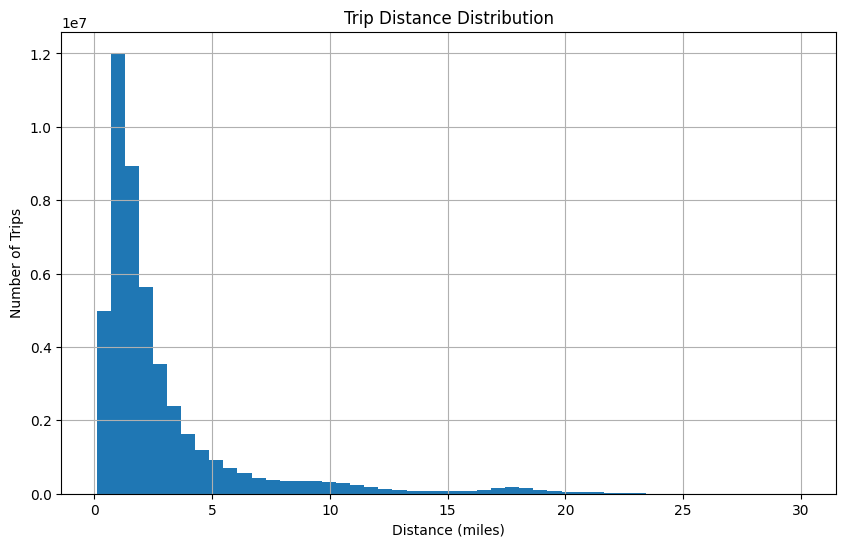

In [17]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
df_clean['trip_distance'].hist(bins=50)
plt.title('Trip Distance Distribution')
plt.xlabel('Distance (miles)')
plt.ylabel('Number of Trips')
plt.savefig('trip_distance_distribution.png')  # Export as PNG
plt.show()  # Show in notebook

In [18]:
import pandas as pd
import plotly.express as px

# Load the dataset
df_clean = pd.read_csv('/kaggle/input/nyc-yellow-taxi-trip-data/yellow_tripdata_2016-01.csv')

# Verify column names
print(df_clean.columns)

# Create the histogram
fig = px.histogram(df_clean, x='trip_distance')

# Save as HTML (no Chrome or kaleido required)
fig.write_html('/kaggle/working/plotly_histogram.html')

# Display in notebook
fig.show()  

Index(['VendorID', 'tpep_pickup_datetime', 'tpep_dropoff_datetime',
       'passenger_count', 'trip_distance', 'pickup_longitude',
       'pickup_latitude', 'RatecodeID', 'store_and_fwd_flag',
       'dropoff_longitude', 'dropoff_latitude', 'payment_type', 'fare_amount',
       'extra', 'mta_tax', 'tip_amount', 'tolls_amount',
       'improvement_surcharge', 'total_amount'],
      dtype='object')


In [19]:
import folium
from folium.plugins import HeatMap

nyc_coords = [40.7128, -74.0060]
m = folium.Map(location=nyc_coords, zoom_start=11)
heat_data = df_clean[['pickup_latitude', 'pickup_longitude']].dropna().sample(n=5000).values.tolist()
HeatMap(heat_data, radius=8).add_to(m)
m.save('nyc_pickup_map.html')  # Export as HTML